# 1. Download data and save to SDS
# 2. Load SDS data & Compute RSAM data (and related metrics)
# 3. Load SDS data & Generate spectrograms (and related metrics)
# 4. Browse RSAM data (and reduced displacement) with scrollable plots
# 5. Browse spectrograms

In [1]:
# 1. Download data and save to SDS
import os
import sys
from obspy.core import UTCDateTime
LIBpath = os.path.join( os.getenv('HOME'),'Documents','GitHub','kitchensinkGT', 'LIB')
sys.path.append(LIBpath)
import obspyGT.SDS
import importlib
importlib.reload(obspyGT.SDS)
#startt = UTCDateTime("2019-12-01T00:00:00.000")
endt = UTCDateTime("2019-12-11T00:00:00.000")
startt = UTCDateTime("2019-06-01T00:00:00.000")
#endt = startt+86400*2
SDS_TOP=os.path.join(os.getenv('HOME'), 'SDS')
trace_ids = ['NZ.WIZ.10.HHZ', 'NZ.WSRZ.10.HHZ']
centerlat=-37.52
centerlon=177.1825
searchRadiusDeg=0.25
fdsnURL = "GEONET"


In [ ]:
import obspyGT.FDSNtools
inv = obspyGT.FDSNtools.get_inventory(fdsnURL, startt, endt, centerlat, centerlon, searchRadiusDeg, network='NZ', station='*', channel='HHZ')
print(inv)
#obspyGT.SDS.FDSN_to_SDS_daily_wrapper(startt, endt, SDS_TOP, centerlat=centerlat, centerlon=centerlon, searchRadiusDeg=searchRadiusDeg, fdsnURL='GEONET')
#obspyGT.SDS.FDSN_to_SDS_daily_wrapper(startt, endt, SDS_TOP, inv=inv, fdsnURL='GEONET')
#obspyGT.SDS.FDSN_to_SDS_daily_wrapper(startt, endt, SDS_TOP, trace_ids=trace_ids, fdsnURL='GEONET')

#

In [ ]:
# 2. Compute CSAM and Drs - should probably add code to remove 0s so i do not get dropouts
sys.path.append('../lib')
import RSAM
importlib.reload(RSAM)
RSAM.SDS_to_RSAM_wrapper(startt, endt, SDS_TOP, sourcelat=centerlat, sourcelon=centerlon, inv=inv, verbose=False)

In [ ]:
import obspy
st=obspy.read('/Users/thompsong/SDS/CSAM/mean/2019/NZ/WSRZ/HHZ.D/NZ.WSRZ.10.HHZ.D.2019.153')
st.plot()

In [ ]:
# 4. Browse RSAM data - just plot for now
rsamWI = RSAM.RSAMobj()
rsamWI.read(startt, endt, SDS_TOP, metric='mean', speed=1, corrected=True)
rsamWI.plot()
drsWI = RSAM.ReducedDisplacementObj()
drsWI.read(startt, endt, SDS_TOP, metric='median', speed=2)
drsWI.plot(type='log')

In [ ]:
def Trace_to_bins(tr, binsizeSecs=86400):
    startt = tr.stats.starttime
    endt = tr.stats.endtime
    windowstart = UTCDateTime(startt.year, startt.month, startt.day, 0, 0, 0)
    binstarts = []
    bins = []
    while windowstart < endt:
        print(windowstart)
        binstarts.append(windowstart)
        bins.append(tr.copy().trim(starttime=windowstart, endtime=windowstart+binsizeSecs).data)
        windowstart += binsizeSecs
    return bins, binstarts
    
bins, binstarts = Trace_to_bins(drsWI.stream[1])


def rsam_violinplot(bins, binstarts, ymax=None):
    import matplotlib.pyplot as plt

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(9, 4))

    all_labels = [t.strftime('%Y-%m-%d') for t in binstarts]
    

    # plot violin plot
    axs[0].violinplot(bins,
                  showmeans=True,
                  showmedians=True, showextrema=True, widths=0.99)
    axs[0].set_title('Violin plot')


    # plot box plot
    axs[1].boxplot(bins)
    axs[1].set_title('Box plot')
        
    # adding horizontal grid lines
    for ax in axs:
        ax.yaxis.grid(True)
        ax.set_xticks([y + 1 for y in range(len(bins))],
                  labels=all_labels, rotation=45, ha='right')
        ax.set_xlabel('Days')
        ax.set_ylabel('Observed values')
        
        # set ymax if asked
        if ymax:
            ax.set_ylim([0,ymax])
            
    plt.show()    
    
rsam_violinplot(bins, binstarts)

In [ ]:
import pandas as pd
def stream2dataframe(st):
    t = pd.Series(this_utcdt.datetime for this_utcdt in st[0].times(type="utcdatetime"))
    df = pd.DataFrame(t,columns=['UTCDateTime'])
    for tr in st:
        df[tr.id] = tr.data
    return df
df = stream2dataframe(rsamWI.stream)
print(df)

Trying to load inventory from 2019/12/09 01:00 to 2019/12/09 01:20


/Users/thompsong/.local/lib/python3.8/site-packages/obspy/io/stationxml/core.py:91: UserWarning: The StationXML file has version 1, ObsPy can read versions (1.0, 1.1). Proceed with caution.
  warnings.warn("The StationXML file has version %s, ObsPy can "


2019-12-09T01:00:00.000000Z
Processing NZ.WIZ.10.HHZ
Processing NZ.WSRZ.10.HHZ
NZ.20191209T010000.png
2019-12-09T01:10:00.000000Z
Processing NZ.WIZ.10.HHZ
Processing NZ.WSRZ.10.HHZ
NZ.20191209T011000.png


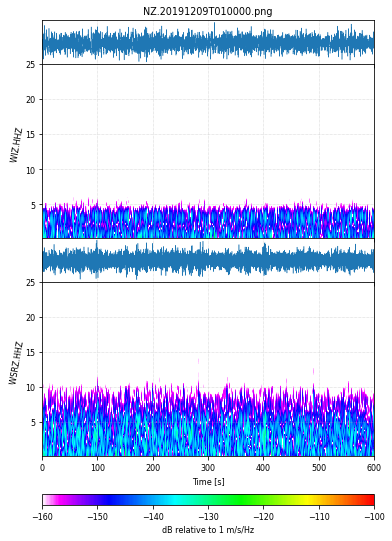

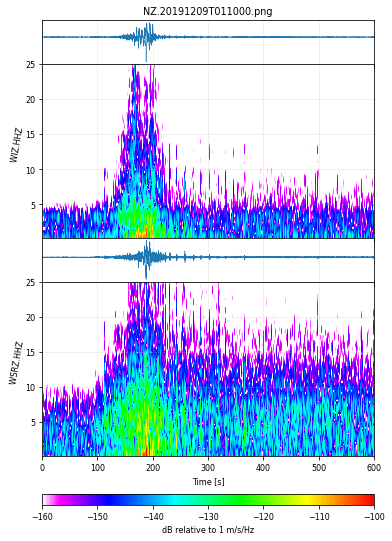

In [40]:
#import sys
#sys.path.append('.')
#import obspy
sys.path.append('../lib')
import IceWeb
import importlib
importlib.reload(IceWeb)
import obspyGT.FDSNtools  

spstartt = UTCDateTime(2019,12,9,1,0,0)
spendt = UTCDateTime(2019,12,9,1,20,0)
inv = obspyGT.FDSNtools.get_inventory(fdsnURL, spstartt, spendt, centerlat, centerlon, searchRadiusDeg, network='NZ', station='*', channel='HHZ')
SDS_to_spectrogram_wrapper(spstartt, spendt, SDS_TOP, trace_ids, windowlength=600, overwrite=True, equal_scale=True, dbscale=True, inv=inv, clim=[1e-8, 1e-5])

Trying to load inventory from 2019/12/09 01:00 to 2019/12/09 01:20


/Users/thompsong/.local/lib/python3.8/site-packages/obspy/io/stationxml/core.py:91: UserWarning: The StationXML file has version 1, ObsPy can read versions (1.0, 1.1). Proceed with caution.
  warnings.warn("The StationXML file has version %s, ObsPy can "


2019-12-09T00:00:00.000000Z
-37.526515575 177.189407876 -37.52 177.1825
-37.51811 177.177805 -37.52 177.1825
2 Trace(s) in Stream:
NZ.WIZ.10.HHZ  | 2019-12-08T23:00:00.003134Z - 2019-12-10T01:00:00.003134Z | 100.0 Hz, 9360001 samples
NZ.WSRZ.10.HHZ | 2019-12-08T23:00:00.003119Z - 2019-12-10T01:00:00.003119Z | 100.0 Hz, 9360001 samples [946.5859029964863, 464.3517723162635]
2 Trace(s) in Stream:
NZ.WSRZ.10.HHZ | 2019-12-08T23:00:00.003119Z - 2019-12-10T01:00:00.003119Z | 100.0 Hz, 9360001 samples
NZ.WIZ.10.HHZ  | 2019-12-08T23:00:00.003134Z - 2019-12-10T01:00:00.003134Z | 100.0 Hz, 9360001 samples [464.3517723162635, 946.5859029964863]
Processing NZ.WSRZ.10.HHZ
Processing NZ.WIZ.10.HHZ
/Users/thompsong/SDS/CSAM/mean/2019/NZ/WSRZ/HHZ.D
/Users/thompsong/SDS/CSAM/mean/2019/NZ/WSRZ/HHZ.D/NZ.WSRZ.10.HHZ.D.2019.343  already contains data. overwriting
/Users/thompsong/SDS/CSAM/mean/2019/NZ/WIZ/HHZ.D
/Users/thompsong/SDS/CSAM/mean/2019/NZ/WIZ/HHZ.D/NZ.WIZ.10.HHZ.D.2019.343  already contains dat

/Users/thompsong/.local/lib/python3.8/site-packages/obspy/io/mseed/core.py:770: UserWarning: The encoding specified in trace.stats.mseed.encoding does not match the dtype of the data.
A suitable encoding will be chosen.
  warnings.warn(msg, UserWarning)


/Users/thompsong/SDS/DRS/median/2019/NZ/WSRZ/HHZ.D
/Users/thompsong/SDS/DRS/median/2019/NZ/WSRZ/HHZ.D/NZ.WSRZ.10.HHZ.D.2019.343  already contains data. overwriting
/Users/thompsong/SDS/DRS/median/2019/NZ/WIZ/HHZ.D
/Users/thompsong/SDS/DRS/median/2019/NZ/WIZ/HHZ.D/NZ.WIZ.10.HHZ.D.2019.343  already contains data. overwriting
NZ.20191209T000000.png
NZ.20191209T001000.png
NZ.20191209T002000.png
NZ.20191209T003000.png
NZ.20191209T004000.png
NZ.20191209T005000.png
NZ.20191209T010000.png
NZ.20191209T011000.png
NZ.20191209T012000.png
NZ.20191209T013000.png
NZ.20191209T014000.png
NZ.20191209T015000.png
NZ.20191209T020000.png
NZ.20191209T021000.png
NZ.20191209T022000.png
NZ.20191209T023000.png
NZ.20191209T024000.png
NZ.20191209T025000.png
NZ.20191209T030000.png
NZ.20191209T031000.png
NZ.20191209T032000.png


../lib/IceWeb.py:130: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(N*2, 1); # create fig and ax handles with approx positions for now


NZ.20191209T033000.png
NZ.20191209T034000.png
NZ.20191209T035000.png
NZ.20191209T040000.png
NZ.20191209T041000.png
NZ.20191209T042000.png
NZ.20191209T043000.png
NZ.20191209T044000.png
NZ.20191209T045000.png
NZ.20191209T050000.png
NZ.20191209T051000.png
NZ.20191209T052000.png
NZ.20191209T053000.png
NZ.20191209T054000.png
NZ.20191209T055000.png
NZ.20191209T060000.png
NZ.20191209T061000.png
NZ.20191209T062000.png
NZ.20191209T063000.png
NZ.20191209T064000.png
NZ.20191209T065000.png
NZ.20191209T070000.png
NZ.20191209T071000.png
NZ.20191209T072000.png
NZ.20191209T073000.png
NZ.20191209T074000.png
NZ.20191209T075000.png
NZ.20191209T080000.png
NZ.20191209T081000.png
NZ.20191209T082000.png
NZ.20191209T083000.png
NZ.20191209T084000.png
NZ.20191209T085000.png
NZ.20191209T090000.png
NZ.20191209T091000.png
NZ.20191209T092000.png
NZ.20191209T093000.png
NZ.20191209T094000.png
NZ.20191209T095000.png
NZ.20191209T100000.png
NZ.20191209T101000.png
NZ.20191209T102000.png
NZ.20191209T103000.png
NZ.20191209

/Users/thompsong/.local/lib/python3.8/site-packages/obspy/io/mseed/core.py:837: UserWarning: Skipping empty trace "NZ.WSRZ.10.HHZ | 2019-12-10T00:00:00.003119Z - 2019-12-10T00:00:00.003119Z | 60.0 s, 0 samples".
  warnings.warn(msg)
/Users/thompsong/.local/lib/python3.8/site-packages/obspy/io/mseed/core.py:837: UserWarning: Skipping empty trace "NZ.WIZ.10.HHZ | 2019-12-10T00:00:00.003134Z - 2019-12-10T00:00:00.003134Z | 60.0 s, 0 samples".
  warnings.warn(msg)


/Users/thompsong/SDS/DRS/median/2019/NZ/WSRZ/HHZ.D
/Users/thompsong/SDS/DRS/median/2019/NZ/WSRZ/HHZ.D/NZ.WSRZ.10.HHZ.D.2019.343  already contains data. overwriting
/Users/thompsong/SDS/DRS/median/2019/NZ/WIZ/HHZ.D
/Users/thompsong/SDS/DRS/median/2019/NZ/WIZ/HHZ.D/NZ.WIZ.10.HHZ.D.2019.343  already contains data. overwriting
NZ.20191209T000000.png
Stream object is empty. Nothing to do
NZ.20191209T001000.png
Stream object is empty. Nothing to do
NZ.20191209T002000.png
Stream object is empty. Nothing to do
NZ.20191209T003000.png
Stream object is empty. Nothing to do
NZ.20191209T004000.png
Stream object is empty. Nothing to do
NZ.20191209T005000.png
Stream object is empty. Nothing to do
NZ.20191209T010000.png
Stream object is empty. Nothing to do
NZ.20191209T011000.png
Stream object is empty. Nothing to do
NZ.20191209T012000.png
Stream object is empty. Nothing to do
NZ.20191209T013000.png
Stream object is empty. Nothing to do
NZ.20191209T014000.png
Stream object is empty. Nothing to do
NZ.2

Traceback (most recent call last):
  File "/Users/thompsong/.local/lib/python3.8/site-packages/IPython/core/interactiveshell.py", line 3398, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/4q/5426zn1d72vgcb6h658n_8800000gn/T/ipykernel_67914/176110424.py", line 23, in <cell line: 23>
    IceWeb.SDS_to_ICEWEB_wrapper(startt, endt, SDS_TOP, sampling_interval=60.0, sourcelat=centerlat, \
  File "../lib/IceWeb.py", line 852, in SDS_to_ICEWEB_wrapper
    fh, ah = spobj.plot(outfile=sgramfile, dbscale=dbscale, title=sgramfile, equal_scale=equal_scale, clim=clim, fmin=freqmin, fmax=freqmax)
  File "../lib/IceWeb.py", line 161, in plot
    [T, F, S] = compute_spectrogram(tr, wlen=secsPerFFT)
  File "../lib/IceWeb.py", line 393, in compute_spectrogram
    S, F, T = mlab.specgram(y, Fs=Fs, NFFT=nfft, pad_to=mult, noverlap=nlap, mode='magnitude')
  File "/Users/thompsong/.local/lib/python3.8/site-packages/matplotlib/mlab.py", line 771, in specgram
    spec, f

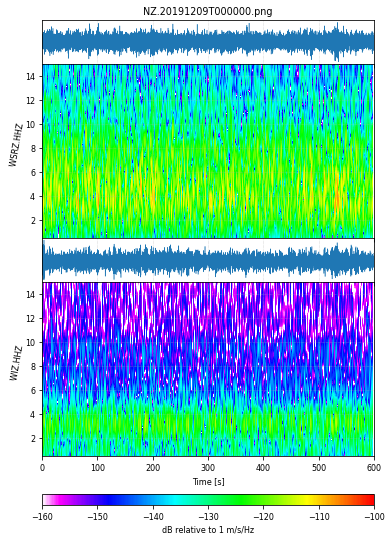

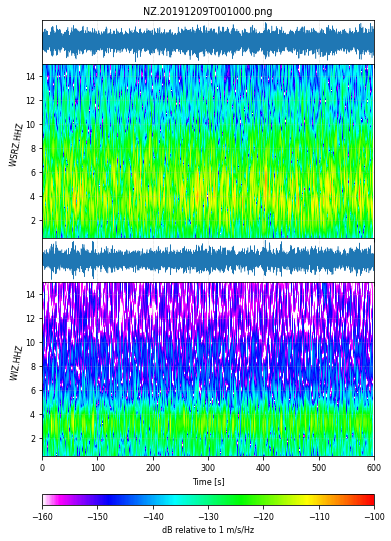

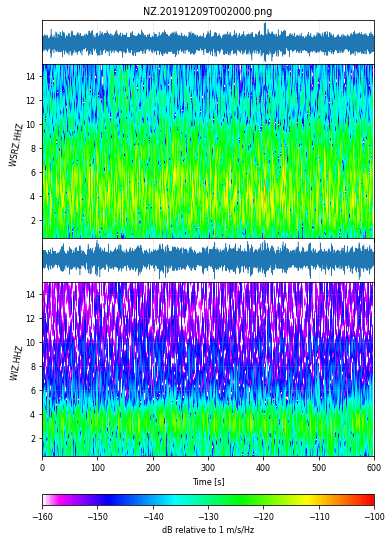

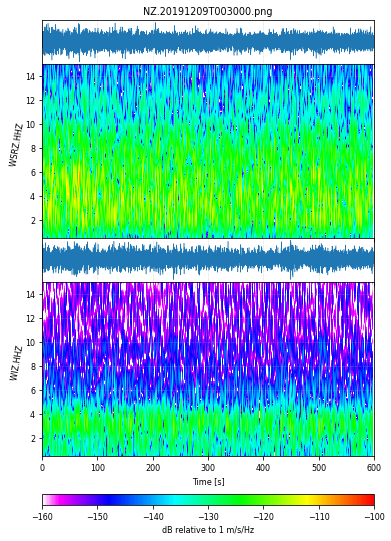

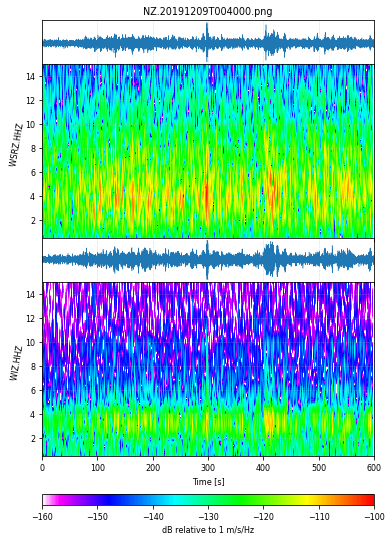

...

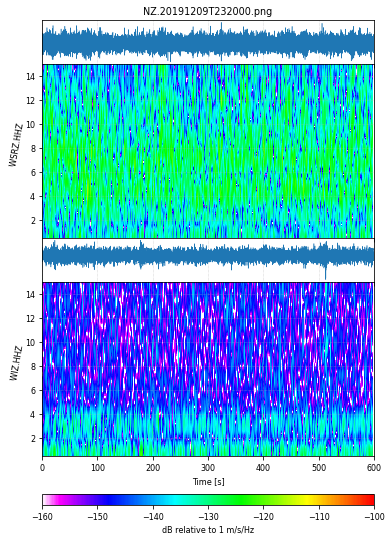

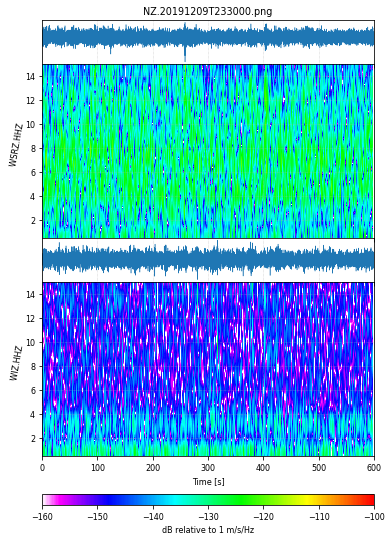

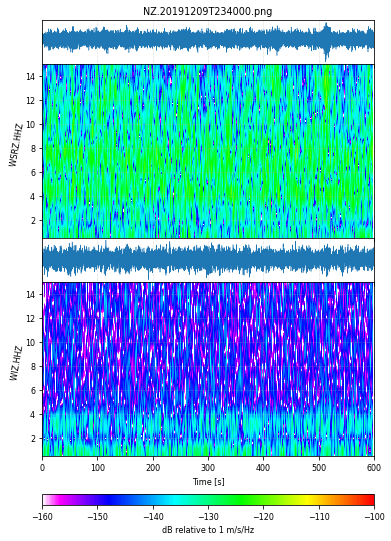

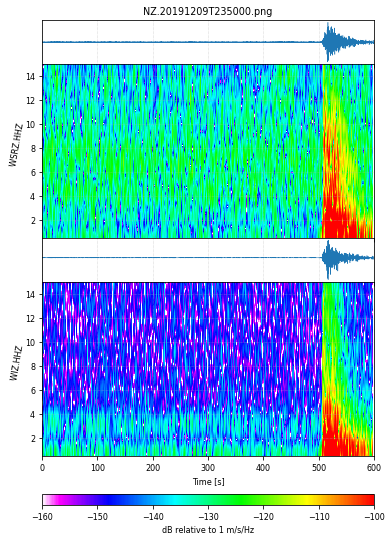

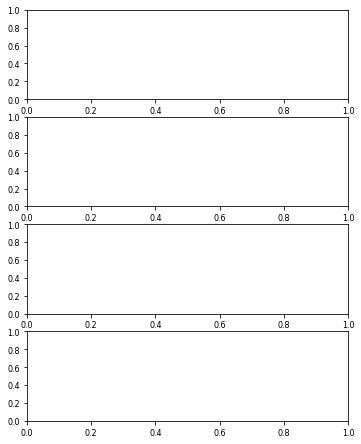

In [56]:
import os
import sys
from obspy.core import UTCDateTime
import importlib

import IceWeb
importlib.reload(IceWeb)
#LIBpath = os.path.join( os.getenv('HOME'),'Documents','GitHub','kitchensinkGT', 'LIB')
#sys.path.append(LIBpath)
import FDSNtools 

SDS_TOP=os.path.join(os.getenv('HOME'), 'SDS')
trace_ids = ['NZ.WIZ.10.HHZ', 'NZ.WSRZ.10.HHZ']
centerlat=-37.52
centerlon=177.1825
searchRadiusDeg=0.25
fdsnURL = "GEONET"

startt = UTCDateTime(2019,12,9)
endt = UTCDateTime(2019,12,10)
inv = FDSNtools.get_inventory(fdsnURL, spstartt, spendt, centerlat, centerlon, searchRadiusDeg, network='NZ', station='*', channel='HHZ')

IceWeb.SDS_to_ICEWEB_wrapper(startt, endt, SDS_TOP, sampling_interval=60.0, sourcelat=centerlat, \
            sourcelon=centerlon, inv=inv, trace_ids=trace_ids, overwrite=True, verbose=False, sgrammins=10, \
                equal_scale=True, dbscale=True, clim=[1e-8, 1e-5])

In [ ]:
import sys
sys.path.append('.')
import obspy
import lib.IceWeb as IceWeb

fname = 'WhiteIslandFinal26Hours_VEL.mseed'
VEL = obspy.read(fname)
data_end_time = VEL[0].stats.endtime

nhours = 2

# Trim data to 1 hour
VEL.trim(starttime=data_end_time-3600*nhours, endtime=data_end_time)
data_start_time = VEL[0].stats.starttime
data_duration = data_end_time - data_start_time
print(data_start_time, data_end_time)

# Split into 10 minute windows
nummins = 10
start_time = data_end_time - nummins * 60
while start_time >= data_start_time:
    end_time = start_time + nummins * 60
    st = VEL.copy().trim(starttime=start_time,endtime=end_time)
    #st.plot();
    start_time = start_time - nummins * 60
    spobj = IceWeb.icewebSpectrogram(stream=st)
    sgramfile = '%s.%s.png' % (st[0].stats.network, st[0].stats.starttime.strftime('%Y%m%dT%H%M%S'))
    if os.path.isfile(sgramfile):
        continue
    else:
        print(sgramfile)
        spobj.plot(outfile=sgramfile, clim=[1e-8, 1e-5], dbscale=True, title='Fixed')
    

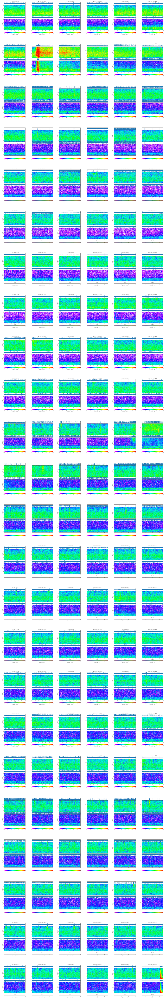

In [62]:
# Next show all images side by side using example from: 
# https://www.geeksforgeeks.org/how-to-display-multiple-images-in-one-figure-correctly-in-matplotlib/
# except, use axes to specify exactly where to plot
# then add prev, next buttons
#import libraries
#import cv2
import imageio as iio
import glob
from matplotlib import pyplot as plt
import numpy as np
  
# create figure
fig = plt.figure(figsize=(18, 144))
  
# reading images
imagefiles = sorted(glob.glob("NZ.*.png"))
#print(imagefiles)
if len(imagefiles)==0:
    raise ValueError('No image files found')
    
# setting values to rows and column variables
nrows = int(np.ceil(len(imagefiles) / 6))
#print(nrows)
ncolumns = int(np.ceil(len(imagefiles) / nrows))
#print(ncolumns)

Images = []
for n,imagefile in enumerate(imagefiles):  
    Images.append(iio.imread(imagefile))
  
    # Adds a subplot at the 1st position
    ax = fig.add_subplot(nrows, ncolumns, n+1)
    l, b, w, h = ax.get_position().bounds
    #print(n, l, b, w, h)
    ll = (n % ncolumns) / ncolumns
    ww = 1/ncolumns
    #print(n, ll, b, ww, h)
    ax.set_position([ll, b, ww, h])
  
    # showing image
    plt.imshow(Images[-1])
    plt.axis('off')
    #plt.title("Sgram %d" % (n+1))
    



In [ ]:
# Plot RSAM data
import os
import pandas as pd
import numpy as np

def compute_rsam(st, rsam_sampling_interval=60):
    # Inputs:
    #    st: a Stream object
    #    rsam_sampling_interval: sampling interval for RSAM data (in seconds)
    # Outputs:
    #    rsam_stream: a downsampled Stream object. 
    
    rsam_stream = st.copy() # we copy the input as it is passed-by-reference and would otherwise be changed in place
    
    for tr in rsam_stream: # Loop over each trace (seismogram)
        x = tr.data # get the data
        
        # now we want to reshape the data vector into an array, so we can take advantage of np.mean()
        s = np.size(x) # find the size of the data vector
        print('%s: size %d' % (tr.id, s))
        nc = int(tr.stats.sampling_rate * rsam_sampling_interval) # number of columns
        nr = int(s / nc) # number of rows
        x = x[0:nr*nc] # cut off any trailing samples
        y = x.reshape((nr, nc))
        print('%s: reshaped to %d x %d array (%d samples)' % (tr.id, nr, nc, nr * nc))
        tr.data = np.mean(abs(y),axis=1) # compute mean for each row (this is vectorised; faster than a for loop)
        tr.stats.sampling_rate = 1.0 / rsam_sampling_interval # update the sampling rate
        print(tr.stats)
        print("")
        
    return rsam_stream


def plot_rsam(st):
    hf = st.plot(handle=True); # standard ObsPy plot
    
    # change the y-axis so it starts at 0
    allAxes = hf.get_axes()
    for ax in allAxes:
        ylims = ax.get_ylim()
        ax.set_ylim([0, ylims[1]])
        
def write_rsam(tr, format='csv'):
    if not format:
        print('No format given for RSAM file. Aborting.')
        return None     
    if format=='csv':
        rsamfile = "%s.%02d.csv" % (tr.id, 1/tr.stats.sampling_rate)
        print('Writing to %s' % rsamfile)
        f = open(rsamfile, "w")
        dt = tr.times(type="UTCDateTime")
        f.write('epoch, data\n')
        for i in range(len(tr.data)):
            f.write("%f, %e\n" % (dt[i].timestamp, tr.data[i]) )
        f.close()
        return rsamfile
    if format=='binary':
        print('BOB binary file writer not implemented yet')
        return 1
    else:
        print('Format %s not recognized' % format)
        return 2
        
    
def read_rsam(rsamfile, format=None):
    if not format:
        print('No format given for RSAM file. Aborting.')
        return None 
    if format=='csv':
        rsambase = os.path.basename(rsamfile)
        net,sta,loc,chan,delta,ext = rsambase.split('.')
        df = pd.read_csv(rsamfile)
        df.columns = df.columns.str.replace(' ', '')
        tr = obspy.Trace()
        tr.id = ".".join((net,sta,loc,chan))
        print(df.columns)
        tr.data = df.data.to_numpy()
        tr.stats.starttime = obspy.UTCDateTime(df.epoch[0])
        tr.stats.delta = delta
        return tr
    if format=='binary':
        print('BOB binary file reader not implemented yet')
        return 1
    else:
        print('Format %s not recognized' % format)
        return 2
    
# 1-minute RSAM
rsam1m = compute_rsam(VEL, rsam_sampling_interval = 60)
plot_rsam(rsam1m);

# save RSAM data
for tr in rsam1m:  
    rsamfile = write_rsam(tr, format='csv')
    tr2 = read_rsam(rsamfile, format='csv')
    print(tr, tr2)